In [ ]:
"""
URLS DATASET:

https://www.kaggle.com/datasets/therohk/global-news-week
_______________________________________________________________________________
https://www.kaggle.com/datasets/sachinkumar62/dragon-ball-dataset

_______________________________________________________________________________
https://www.kaggle.com/datasets/snap/amazon-fine-food-reviews:
#!/bin/bash
!kaggle datasets download snap/amazon-fine-food-reviews


"""

'\nURLS DATASET:\n\nhttps://www.kaggle.com/datasets/therohk/global-news-week\n_______________________________________________________________________________\nhttps://www.kaggle.com/datasets/sachinkumar62/dragon-ball-dataset\n\n_______________________________________________________________________________\nhttps://www.kaggle.com/datasets/snap/amazon-fine-food-reviews:\n#!/bin/bash\n!kaggle datasets download snap/amazon-fine-food-reviews\n\n\n'

In [ ]:
# #Extraer achivos tipo zip en el directorio actual
# import zipfile
# import os
# path_data = "/content/amazon-fine-food-reviews.zip"
# with zipfile.ZipFile(path_data, 'r') as zip_ref:
#     zip_ref.extractall()

# INTRODUCCIÓN

<div align="justify">

De la exploración de repositorios de los tres posibles datasets se ha elejido el dataset de crìticas de comida de Amazon. Esto debido a dos razones principales.
La primera razón es que, con este dataset se puede realizar un ejercicio común de NLP; el análisis de sentimientos.
La segunda razón es por la calidad del dataset; si bien el dataset. El presente dataset ontiene una columna de texto denominada "text" en el que se encuentra la reseña realizada a algùn producto de comida de Amazon; por lo que es beneficioso para practicar las técnicas comunes de pre-procesamiento de texto y podemos comparar las herramientas a utilizar entre el texto limpio y el texto original y ver cómo afecta a los modelos los cambios realizados

</div>

<div align="center">

Abrir Notebook en Colab: 

[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1fxziT34PRXlduwgMwnEsbHllDMiCr-UV?usp=sharing) 

</div>

# Objetivo

Utilizar sobre el dataset elegido las herramientas y modelos más comunes para NLP.

# SETUP

In [ ]:
#LIBRERIAS COMUNES
import numpy as np
import pandas as pd
import random

#VISUALIZACIÓN DE DATOS
import matplotlib.pyplot as plt
import seaborn as sns

#LIBRERIAS PARA NLP
import spacy
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from textblob import TextBlob
import re

#REPRESENTACIÓN DE TEXTO - EMBEDDINGS Y REPRESENTACION ESPACIOS LATENTES
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
import gensim
from gensim.models import Word2Vec
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.manifold import TSNE


# TRANSFORMERS PREENTRENADOS
from transformers import pipeline

In [ ]:
#Semilla
random.seed(42)

# DATASET EXPLORATION

Como primer paso realizaremos una muy breve exploración del dataset; esto para darnos una idea de que podemos encontrar y sobre todo que tipo de texto existe en la columna "text". donde se encuentra la reseña.  

In [ ]:
df_foodReview = pd.read_csv("/content/Reviews.csv")

In [ ]:
df_foodReview.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


Si quisieramos entrenar algun modelo con los datos presentes en el dataset; primero nos serviría ver cual es la distribución de los datos en base a la columna "score". De esta forma, si queremos dividir el dataset en "entrenamiento, validacion y prueba" podremos decidir cómo realizar la división de manera correcta (estratificación)

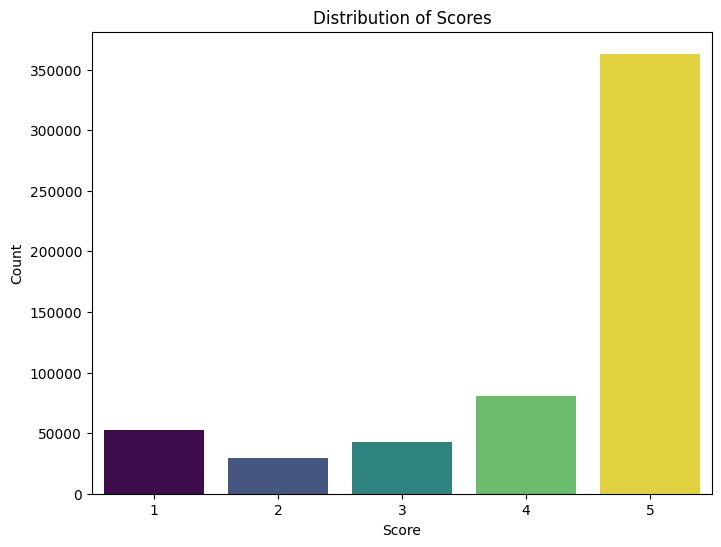

In [ ]:
#Visualización de la distribución del Score
plt.figure(figsize=(8, 6))
sns.countplot(data=df_foodReview, x='Score', palette='viridis', hue='Score', legend=False)
plt.title("Distribution of Scores")
plt.xlabel("Score")
plt.ylabel("Count")
plt.show()



In [ ]:
print("Total de reseñas escritas: ", df_foodReview["Text"].shape[0])

Total de reseñas escritas:  568454


Ya que el dataset es muy grande para el entorno de ejecución del ejercicio; utilizaremos una muestra aleatoria de las reseñas.

In [ ]:
#Recolección del 1% de los datos de texto
df_foodReview = df_foodReview.sample(frac=0.01, random_state=42)

In [ ]:
print("Total de muestras aleatorias escogidas: ", df_foodReview["Text"].shape[0])

Total de muestras aleatorias escogidas:  5685


In [ ]:
#Selección aleatoria de 20 elementos de la lista para visualizar
df_foodReview["Text"].sample(20)

,Text
373878,I would not have had the confidence or time to...
295308,Pureed habanero peppers. Just perfect!<br /><b...
52798,The Jello Fat Free puddings are and excellent ...
460668,I know this is supposed to be for men with pro...
277881,I get this at WHOLE FOODS for $4.59 per 32 oz....
121053,I prefer soft licorice. I do NOT prefer salt l...
122147,The Xylitol quality is great and made the perf...
406345,My husband wont put ANYTHING else in his coffe...
283608,"Nice mix ,what really suprised me is the fact ..."
98060,And we have tried a few. This tea is flavorful...


De lo anterior podemos visualizar que existen algunas reseñas con caracateres espeaciles; etiquetas html, combinación de minúsculas y mayúsculas, etc.

## Procesamiento del texto

Trataremos a cada reseña como un texto único; por lo que las usaremos como una oración.

In [ ]:
#Extración de la columna texto y guardada en un lista
original_text_data = df_foodReview["Text"].tolist()
text_data = original_text_data.copy()

## Limpieza del texto

In [ ]:
#Eliminación de contenido etiquetas html
def remove_html_tags(text):
    html_pattern = re.compile('<.*?>')
    return html_pattern.sub(r'', text)

In [ ]:
#Eliminación de urls:
def remove_urls(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    return url_pattern.sub(r'', text)


In [ ]:
#Eliminacion de caracteres especiales, puntuacion y dígitos (solo se dejan las palabras con letras)
def remove_special_characters(text):
    pattern = r'[^a-zA-Z\s]'
    text = re.sub(pattern, '', text)
    return text

In [ ]:
#Eliminación de caracteres ilegales
def remove_ilegal_chars(text):
  if isinstance(text, str):
    pattern=r'[^\x20-\x7E\u00A0-\u00FF]'
    text = re.sub(pattern, '', text)
  return text

In [ ]:
#Eliminamos palabras que contengan varias veces una misma letra repetida y lo reducimos a máximo 2.
def reduce_repeated_chars(text):
  pattern=r'(\w)\1{2,}'
  replacer=r'\1\1'
  text = re.sub(pattern, replacer, text)
  return text

In [ ]:
#Eliminanos las palabras que contengan solo 2 caracaters (los cuales sean dos consonantes seguidas) "cc; ff; tq..."
def remove_short_words(text):
  pattern=  r'\b[bcdfghjklmnpqrstvwxyz]{2}\b'
  text = re.sub(pattern, '', text)
  return text

In [ ]:
text_data = [remove_html_tags(text) for text in text_data]
text_data = [remove_urls(text) for text in text_data]
text_data = [remove_special_characters(text) for text in text_data]
text_data = [remove_ilegal_chars(text) for text in text_data]
text_data = [text.lower() for text in text_data]
text_data = [reduce_repeated_chars(text) for text in text_data]
text_data = [remove_short_words(text) for text in text_data]
#text_data = [str(TextBlob(text).correct()) for text in text_data] #Corrección Ortografica

El dataset encontrado, al ser reviews de productos que se pueden encontrar en amazon, se tuvo que aplicar algunas técnicas de  limpieza de datos.
Siendo las más importantes la eliminación de digitos, espacios y eliminación de etiquetas HTML. Si bien el texto tiene muchos más puntos de mejora; debido a las limitaciones computacionales no se intenta, por ejemplo corregir gramaticalmente (con alguna librería) cada una de las palabras que contienen las oraciones.

In [ ]:
print("Original: ",original_text_data[0])
print("###############################")
print("Limpio: ",text_data[0])

Original:  Having tried a couple of other brands of gluten-free sandwich cookies, these are the best of the bunch.  They're crunchy and true to the texture of the other "real" cookies that aren't gluten-free.  Some might think that the filling makes them a bit too sweet, but for me that just means I've satisfied my sweet tooth sooner!  The chocolate version from Glutino is just as good and has a true "chocolatey" taste - something that isn't there with the other gluten-free brands out there.
###############################
Limpio:  having tried a couple of other brands of glutenfree sandwich cookies these are the best of the bunch  theyre crunchy and true to the texture of the other real cookies that arent glutenfree  some might think that the filling makes them a bit too sweet but for me that just means ive satisfied  sweet tooth sooner  the chocolate version from glutino is just as good and has a true chocolatey taste  something that isnt there with the other glutenfree brands out th

In [ ]:
#Ejemplo reduce repeated chars:
text_ejemplo = "This productt is soooo amaziiing!!!; I've loooooved it; it's so cool"
print("Texto original: ", text_ejemplo)
print("###############################")
text_ejemplo = reduce_repeated_chars(text_ejemplo)
print("Texto corregido: ",text_ejemplo)
print("###############################")
blob = TextBlob(text_ejemplo)
print("Texto final corregido con TextBlob: ", blob.correct())

Texto original:  This productt is soooo amaziiing!!!; I've loooooved it; it's so cool
###############################
Texto corregido:  This productt is soo amaziing!!!; I've looved it; it's so cool
###############################
Texto final corregido con TextBlob:  His products is so amazing!!!; I've looked it; it's so cool


Se intento utilizar **TextBlob** para mitigar el problema de los caracteres repetidos; sin embargo la libreria cambia las palabras; por lo que no es adecuado para nuestro fin; podría cambiar algun signifciado importante ( Por ejemplo, Loved lo cambio a Looked). En este caso, será mejor utilizar solo el resultado obtenido con la expresión regular.

In [ ]:
#DATA CLEANED:
text_data

['having tried a couple of other brands of glutenfree sandwich cookies these are the best of the bunch  theyre crunchy and true to the texture of the other real cookies that arent glutenfree  some might think that the filling makes them a bit too sweet but for me that just means ive satisfied  sweet tooth sooner  the chocolate version from glutino is just as good and has a true chocolatey taste  something that isnt there with the other glutenfree brands out there',
 ' cat loves these treats if ever i cant find her in the house i just pop the top and she bolts out of wherever she was hiding to come get a treat she doesnt like crunchy treats much so these are perfect for her ive given her all three flavors and she seems to like them all equally they do tend to dry out  the time i near the end of the bottle however the fliptop lid is very handy very nice inexpensive kitty treats i have yet to meet a cat that doesnt just love these',
 'a little less than i expected  it tends to have a mudd

Al final del procesamiento del texto podemos visualizar que, dadas las reglas impuestas en las expresiones regulares, contamos con un texto más limpio y compuesto únicamente por letras del abecedario.

# EJERCICIO 1
Implementación de Bag of Words y TF-IDF


## BAG OF WORDS

In [ ]:
vectorizer_bow = CountVectorizer()
bow_matrix = vectorizer_bow.fit_transform(text_data)
bow_matrix

<5685x19630 sparse matrix of type '<class 'numpy.int64'>'
	with 295660 stored elements in Compressed Sparse Row format>

In [ ]:
bow_df = pd.DataFrame(bow_matrix.toarray(), columns=vectorizer_bow.get_feature_names_out())

In [ ]:
bow_df.head()

,aachen,aafco,aafcoa,ab,aback,abandoned,abc,aberration,abhor,abietate,...,ziwipeak,zoey,zojirushi,zola,zoloft,zone,zoo,zotz,zucchini,zukes
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Podemos observar que, del 1% de los datos de texto seleccionados, se ha constituido cerca de 19630 paralabras para nuestra bolsa de palabras

In [ ]:
#Encontrmos las filas que contengan "1" dada una columna de la matrz BOW
result = bow_df[bow_df['the'] >= 1 ]
result.shape

(4646, 19630)

In [ ]:
result[["the", "and"]]

,the,and
0,7,2
1,6,2
2,2,0
3,10,5
4,7,7
...,...,...
5678,1,1
5679,4,2
5680,2,2
5682,2,2


<div align="justify">
De este ejercicio podemos concluir que BoW es una técnica que nos permite vectorizar un documento en base al vocabulario de un corpus específico. Esto representa una desventaja para nuevas frases; ya que al utilizar esta técnica con un nuevo documento (frase) o en este caso reseña, las palabras que no esten dentro del corpus inicial no serán tomadas en cuenta dando como resultado, si hay muchas palabras que no estan en el corpus, una representación vectorial muy escasa.
</div>

## TF-IDF

In [ ]:
# TF-IDF
vectorizer_tfidf = TfidfVectorizer()
tfIdf_matrix = vectorizer_tfidf.fit_transform(text_data)
tfidf_df = pd.DataFrame(tfIdf_matrix.toarray(), columns=vectorizer_tfidf.get_feature_names_out())

In [ ]:
tfidf_df

,aachen,aafco,aafcoa,ab,aback,abandoned,abc,aberration,abhor,abietate,...,ziwipeak,zoey,zojirushi,zola,zoloft,zone,zoo,zotz,zucchini,zukes
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5680,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5681,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5682,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5683,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
#Encontrmos las filas que contengan "1" dada una columna de la matrz BOW
result_idf = tfidf_df[tfidf_df['the'] > 0.5]
result_idf.shape

(0, 19630)

<div align="justify">
Ya que anteriormente visualizamos que "the" es una palabra muy común veremos que tanto representa esta palabra en todos los documentos.

In [ ]:
tfidf_df['the']

,the
0,0.199163
1,0.156273
2,0.121963
3,0.125313
4,0.173640
...,...
5680,0.090303
5681,0.000000
5682,0.063885
5683,0.000000


<div align="justify">
De este ejercicio podemos concluir que dado un vocabulario de un corpus específico podemos obtener una representación vectorial más fiable que BoW; ya que esta técnica no considera, para la representación vectorial, la aparición de dicha palabra; si no que mide, en base a la frecuencia de aparición en los otros documentos, que tan representativa es la palabra del vocabulario para el documento en específico. Sin embargo, tambien parece tener la misma desventaja de BoW; si añadimos un documento con muchas palabras fuera del vocabulario, tendremos una representación vectorial muy baja. 
En nuestro caso, dado a que tenemos una matriz dispersa podemos concluir que muchas de las palabras del vocabulario, de la misma manera que paso en BoW, aparecen solo una vez en un documento específico; es decir, muchas palabras son irrelevantes para cada documento en específico. Para comprobar esto, volvemos a filtrar la matriz con la palabra "the"; y como podemos observar en la matriz anterior esta palabra es muy común (cómo lo corroboramos en BoW) por lo que su valor es muy bajo (todas por debajo del 0.2)

### Ejercicio Adicional 1

#### Texto Limpio

In [ ]:
# Utilizamos el anterior tfIdf_matrix
cosine_sim = cosine_similarity(tfIdf_matrix, tfIdf_matrix) #Calculo de la similaridad del coseno
df_sim = pd.DataFrame(cosine_sim,
                      columns=[f"Reseña-{i+1}" for i in range(len(text_data))],
                      index= [f"Reseña-{i+1}" for i in range(len(text_data))])
df_sim

,Reseña-1,Reseña-2,Reseña-3,Reseña-4,Reseña-5,Reseña-6,Reseña-7,Reseña-8,Reseña-9,Reseña-10,...,Reseña-5676,Reseña-5677,Reseña-5678,Reseña-5679,Reseña-5680,Reseña-5681,Reseña-5682,Reseña-5683,Reseña-5684,Reseña-5685
Reseña-1,1.000000,0.111147,0.044996,0.166644,0.137561,0.011910,0.049771,0.059010,0.092221,0.098183,...,0.058623,0.101799,0.027384,0.019846,0.082929,0.089981,0.030365,0.065655,0.028736,0.046066
Reseña-2,0.111147,1.000000,0.047701,0.101240,0.096373,0.014922,0.057590,0.054296,0.095193,0.070979,...,0.058545,0.087384,0.053265,0.087733,0.113992,0.022637,0.038077,0.134110,0.025910,0.072676
Reseña-3,0.044996,0.047701,1.000000,0.083661,0.096837,0.009725,0.032793,0.046581,0.058590,0.023515,...,0.060082,0.086567,0.041770,0.042876,0.085051,0.011014,0.051858,0.075481,0.042187,0.058264
Reseña-4,0.166644,0.101240,0.083661,1.000000,0.151138,0.053603,0.095139,0.109033,0.132135,0.073786,...,0.081700,0.128670,0.070891,0.072004,0.121285,0.063321,0.084338,0.104389,0.060861,0.067632
Reseña-5,0.137561,0.096373,0.096837,0.151138,1.000000,0.023592,0.060922,0.077564,0.101502,0.095156,...,0.087210,0.076155,0.106487,0.048960,0.156878,0.070109,0.079034,0.092430,0.088259,0.046739
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Reseña-5681,0.089981,0.022637,0.011014,0.063321,0.070109,0.000000,0.037702,0.015619,0.038914,0.048224,...,0.030647,0.021878,0.019658,0.060127,0.066270,1.000000,0.052110,0.025384,0.071750,0.004120
Reseña-5682,0.030365,0.038077,0.051858,0.084338,0.079034,0.019395,0.076204,0.061871,0.054059,0.019721,...,0.064165,0.080646,0.113325,0.043089,0.065874,0.052110,1.000000,0.088155,0.074662,0.061436
Reseña-5683,0.065655,0.134110,0.075481,0.104389,0.092430,0.039865,0.066570,0.042299,0.101263,0.078813,...,0.061804,0.077889,0.055700,0.031710,0.097367,0.025384,0.088155,1.000000,0.094138,0.048855
Reseña-5684,0.028736,0.025910,0.042187,0.060861,0.088259,0.000000,0.108940,0.012831,0.062938,0.077204,...,0.031725,0.013567,0.105557,0.044708,0.082018,0.071750,0.074662,0.094138,1.000000,0.047340


In [ ]:
#Encontramos las filas en donde la columna "x" tenga una similaridad mayor a 0.5
result = df_sim[df_sim['Reseña-1'] >= 0.2]["Reseña-1"]
result

,Reseña-1
Reseña-1,1.000000
Reseña-352,0.214967
Reseña-1169,0.263440
Reseña-1207,0.228253
Reseña-1350,0.265443
Reseña-1358,0.244152
Reseña-1533,0.201105
Reseña-1783,0.206128
Reseña-2019,0.213907
Reseña-2072,0.225894


#### Texto "Original"

In [ ]:
# Representación TF-IDF
tfidf_vectorizer = TfidfVectorizer()
tfidf_matrix = tfidf_vectorizer.fit_transform(original_text_data)
# Calcular la similitud coseno entre todos los documentos
cosine_sim = cosine_similarity(tfidf_matrix, tfidf_matrix)
# Mostrar la matriz de similitud
df_sim = pd.DataFrame(cosine_sim, columns=[f'Reseña-{i+1}' for i in range(len(original_text_data))],
                      index=[f'Reseña-{i+1}' for i in range(len(original_text_data))])
df_sim

,Reseña-1,Reseña-2,Reseña-3,Reseña-4,Reseña-5,Reseña-6,Reseña-7,Reseña-8,Reseña-9,Reseña-10,...,Reseña-5676,Reseña-5677,Reseña-5678,Reseña-5679,Reseña-5680,Reseña-5681,Reseña-5682,Reseña-5683,Reseña-5684,Reseña-5685
Reseña-1,1.000000,0.113673,0.051259,0.166102,0.161427,0.012036,0.049868,0.061874,0.122828,0.101638,...,0.059774,0.130534,0.037734,0.019153,0.081284,0.127320,0.038340,0.080174,0.032275,0.049489
Reseña-2,0.113673,1.000000,0.047324,0.096625,0.095761,0.030810,0.056765,0.056297,0.099251,0.073574,...,0.058786,0.094500,0.056088,0.083221,0.111875,0.022625,0.036804,0.147998,0.028794,0.068766
Reseña-3,0.051259,0.047324,1.000000,0.077245,0.097085,0.009812,0.030992,0.047236,0.060133,0.023664,...,0.060720,0.093491,0.039829,0.040163,0.080036,0.011146,0.048658,0.073629,0.038742,0.057035
Reseña-4,0.166102,0.096625,0.077245,1.000000,0.168498,0.049675,0.087565,0.102666,0.141278,0.070824,...,0.077187,0.135844,0.065405,0.060650,0.159557,0.061844,0.079546,0.124949,0.058790,0.062771
Reseña-5,0.161427,0.095761,0.097085,0.168498,1.000000,0.023314,0.060986,0.089089,0.114700,0.094283,...,0.089997,0.086823,0.106866,0.049963,0.177228,0.071867,0.076566,0.103171,0.088696,0.047474
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Reseña-5681,0.127320,0.022625,0.011146,0.061844,0.071867,0.000000,0.037918,0.015928,0.043343,0.048384,...,0.031261,0.024259,0.019963,0.057411,0.059456,1.000000,0.050991,0.024947,0.072338,0.004211
Reseña-5682,0.038340,0.036804,0.048658,0.079546,0.076566,0.018809,0.073358,0.061746,0.051870,0.018900,...,0.049824,0.084665,0.109847,0.039490,0.061249,0.050991,1.000000,0.084090,0.070822,0.059145
Reseña-5683,0.080174,0.147998,0.073629,0.124949,0.103171,0.035120,0.065055,0.049363,0.115479,0.093635,...,0.051979,0.082158,0.066958,0.029878,0.132115,0.024947,0.084090,1.000000,0.103576,0.075807
Reseña-5684,0.032275,0.028794,0.038742,0.058790,0.088696,0.000000,0.105923,0.017429,0.062619,0.084419,...,0.032231,0.014966,0.110903,0.041796,0.082547,0.072338,0.070822,0.103576,1.000000,0.049192


In [ ]:
result_ori = df_sim[df_sim['Reseña-1'] >= 0.2]["Reseña-1"]
result_ori

,Reseña-1
Reseña-1,1.000000
Reseña-48,0.201303
Reseña-139,0.238887
Reseña-321,0.200735
Reseña-352,0.211255
...,...
Reseña-5355,0.215725
Reseña-5372,0.234042
Reseña-5560,0.232360
Reseña-5579,0.215108


#### Comparación entre el texto limpio y original para la primera columna

In [ ]:
result.head(10), result_ori.head(10)

(Reseña-1       1.000000
 Reseña-352     0.214967
 Reseña-1169    0.263440
 Reseña-1207    0.228253
 Reseña-1350    0.265443
 Reseña-1358    0.244152
 Reseña-1533    0.201105
 Reseña-1783    0.206128
 Reseña-2019    0.213907
 Reseña-2072    0.225894
 Name: Reseña-1, dtype: float64,
 Reseña-1       1.000000
 Reseña-48      0.201303
 Reseña-139     0.238887
 Reseña-321     0.200735
 Reseña-352     0.211255
 Reseña-543     0.239897
 Reseña-553     0.216303
 Reseña-562     0.281273
 Reseña-973     0.214713
 Reseña-1169    0.268422
 Name: Reseña-1, dtype: float64)

<div align="justify">

Para el ejercicio adicional 1 utilizamos la matriz TF-IDF generada anteriormente; Ya que cada dicha matriz es la representación vectorial de cada documento en base a un vocabulario específico podemos realizar operaciones sobre estos vectores; por ejemplo, podemos calcular la \textbf{similaridad del coseno}; para esto utilizamos la libreria de sklearn \textbf{pairwise}; la cual al aceptar dos matrices como entrada calcula la similitud del coseno entre cada uno de los vectores (filas) de la matriz, como resultado obtenemos qué tanto se "alinean" los vectores, es decir, en que porcentaje las reseñas son parecidas entre sí en función de \textbf{contenido textual}. Ya que, la matriz TF-IDF no tienen valores menores a cero podemos concluir que los vectores que sean cercanos a 1 contienen reseñas muy similares o parecidas y los vectores cercanos a 0 son reseñas opuestas (los vectores son ortogonales). De lo anterior, como podemos observar en la tabla 6; podemos notar que en la diagonal el cálculo de similaridad del coseno es 1; esto ya que, básicamente
se compara el documento (la reseña) con sigo misma (el contenido es 100\% idéntico).

Adicionalmente; es interesante ver que en la comparación de la reseña 1 del texto original y el texto "limpio" no hay mucha variación en base al contenido textual de cada documento. Tal vez esto se deba a que para la reseña 1, en base al contenido textual con las otras reseñas, no exista muchos caracteres poco comunes por lo que en la limpieza y el texto original se "maneja" una similitud parecida

# Ejercicio 2: PROCESAMIENTO DE TEXTO CON SPACY y NLTK
## Combinado con ejercicio adicional 2: Extracción de Entidades Nombradas y Análisis de Dependencias

In [ ]:

# Descargar recursos de NLTK
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('punkt_tab')
nlp = spacy.load("en_core_web_sm")

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


<div align="justify">

El primer método "Word Tokenize" separa nuestro texto, cada documento, en palabras individuales; es decir "tokens"; de esta manera podemos obtener cómo tokens las palabras de cada documento; 

Por otro lado; al aplicar el método "Stop Words" (en inglés) no se toman en cuenta las palabras comunes que puedan aparecer en los documentos; por ejemplo palabras como "a", "of", "the", etc. son omitidas. De esta manera, se obtienen, de cierta forma, solo palabras "relevantes".

Para spaCY  utilizamos el modelo "en\_core\_web\_sm" el cual es solamente el modelo en inglés de spaCy. Para este modelo en particular podemos usar tanto el texto limpio como el texto original y obtener el mismo resultado; esto debido al modelo en inglés que se carga a spaCy y el uso de los tokens generados anteriormente sin considerar stopwords ni puntuación y números. Adicionalmente, con spCy podemos generar "lemmas" que son solamente las palabras lematizadas (en su forma base); esto ciertamente parece más avanzado que los Stop Words de NLTK; ya que en vez de eliminar palabras, las generaliza. Por ejemplo, la palabra "best" fue transformada a "good". 

In [ ]:
#PREPROCESAMIENTO CON NLTK
tokens = [word_tokenize(text) for text in text_data] #Tokenizacion clean data
stop_words = set(stopwords.words('english'))
filtered_tokens = [[word for word in text if word.lower() not in stop_words] for text in tokens]

## Datos con el texto Limpio

In [ ]:
print("Tokenización con NLTK:", tokens)
print("Texto sin stopwords con NLTK:", filtered_tokens)

Tokenización con NLTK: [['having', 'tried', 'a', 'couple', 'of', 'other', 'brands', 'of', 'glutenfree', 'sandwich', 'cookies', 'these', 'are', 'the', 'best', 'of', 'the', 'bunch', 'theyre', 'crunchy', 'and', 'true', 'to', 'the', 'texture', 'of', 'the', 'other', 'real', 'cookies', 'that', 'arent', 'glutenfree', 'some', 'might', 'think', 'that', 'the', 'filling', 'makes', 'them', 'a', 'bit', 'too', 'sweet', 'but', 'for', 'me', 'that', 'just', 'means', 'ive', 'satisfied', 'sweet', 'tooth', 'sooner', 'the', 'chocolate', 'version', 'from', 'glutino', 'is', 'just', 'as', 'good', 'and', 'has', 'a', 'true', 'chocolatey', 'taste', 'something', 'that', 'isnt', 'there', 'with', 'the', 'other', 'glutenfree', 'brands', 'out', 'there'], ['cat', 'loves', 'these', 'treats', 'if', 'ever', 'i', 'cant', 'find', 'her', 'in', 'the', 'house', 'i', 'just', 'pop', 'the', 'top', 'and', 'she', 'bolts', 'out', 'of', 'wherever', 'she', 'was', 'hiding', 'to', 'come', 'get', 'a', 'treat', 'she', 'doesnt', 'like', '

In [ ]:
doc = [nlp(text) for text in text_data]

In [ ]:
lemmas = [[token.lemma_ for token in docs if not token.is_stop and token.is_alpha] for docs in doc]

In [ ]:
print("\nLematización con spaCy:", lemmas)


Lematización con spaCy: [['having', 'try', 'couple', 'brand', 'glutenfree', 'sandwich', 'cookie', 'good', 'bunch', 'crunchy', 'true', 'texture', 'real', 'cookie', 'not', 'glutenfree', 'think', 'filling', 'make', 'bit', 'sweet', 'mean', 've', 'satisfy', 'sweet', 'tooth', 'soon', 'chocolate', 'version', 'glutino', 'good', 'true', 'chocolatey', 'taste', 'not', 'glutenfree', 'brand'], ['cat', 'love', 'treat', 'not', 'find', 'house', 'pop', 'bolt', 'hide', 'come', 'treat', 'not', 'like', 'crunchy', 'treat', 'perfect', 've', 'give', 'flavor', 'like', 'equally', 'tend', 'dry', 'time', 'near', 'end', 'bottle', 'fliptop', 'lid', 'handy', 'nice', 'inexpensive', 'kitty', 'treat', 'meet', 'cat', 'not', 'love'], ['little', 'expect', 'tend', 'muddy', 'taste', 'expect', 'say', 'favorite', 'company'], ['frost', 'miniwheat', 'original', 'size', 'frost', 'miniwheat', 'bite', 'size', 'reason', 'mouthful', 'frost', 'miniwheat', 'little', 'bit', 'yes', 'half', 'size', 'bite', 'size', 'version', 'particula

### Ejercicio Adicional 2

#### Entidades Nombradas

In [ ]:
#Extracción de entidades nombradas
count = 0;
for sentence in doc:
  for ent in sentence.ents:
    if count == 1:
      break;
    print(f"Entidad: {ent.text}, Tipo: {ent.label_}")
  count += 1;

Entidad: first, Tipo: ORDINAL
Entidad: about half, Tipo: CARDINAL
Entidad: carefulthese, Tipo: NORP
Entidad: one, Tipo: CARDINAL
Entidad: two, Tipo: CARDINAL
Entidad: first, Tipo: ORDINAL
Entidad: first, Tipo: ORDINAL
Entidad: about a minute, Tipo: TIME
Entidad: about a minute, Tipo: TIME
Entidad: singapore, Tipo: GPE
Entidad: saturday, Tipo: DATE
Entidad: morning, Tipo: TIME
Entidad: two, Tipo: CARDINAL
Entidad: a few months, Tipo: DATE
Entidad: marley coffee, Tipo: ORG
Entidad: only one, Tipo: CARDINAL
Entidad: marley coffee, Tipo: ORG
Entidad: one, Tipo: CARDINAL
Entidad: uk, Tipo: GPE
Entidad: christmas, Tipo: DATE
Entidad: christmas, Tipo: DATE
Entidad: one, Tipo: CARDINAL
Entidad: americans, Tipo: NORP
Entidad: two, Tipo: CARDINAL
Entidad: mexican, Tipo: NORP
Entidad: tomorrow, Tipo: DATE
Entidad: the next day, Tipo: DATE
Entidad: satin ice, Tipo: PERSON
Entidad: five, Tipo: CARDINAL
Entidad: korean, Tipo: NORP
Entidad: korean, Tipo: NORP
Entidad: last weekend, Tipo: DATE
Entidad

#### Análisis de Dependencias

In [ ]:
#Análisis de Dependencias
count = 0;
for sentence in doc:
  for token in sentence:
    if count == 2:
      break;
    print(f"Token: {token.text:10}, Dependencia: {token.dep_:10}, {token.head.text:10}")
  count += 1;

Se han truncado las últimas 5000 líneas del flujo de salida.
Token: a         , Dependencia: det       , tea       
Token: very      , Dependencia: advmod    , fine      
Token: fine      , Dependencia: amod      , tea       
Token: tasting   , Dependencia: amod      , tea       
Token: rooibos   , Dependencia: amod      , tea       
Token: tea       , Dependencia: attr      , is        
Token:           , Dependencia: dep       , tea       
Token: i         , Dependencia: nsubj     , read      
Token: read      , Dependencia: relcl     , tea       
Token: a         , Dependencia: det       , review    
Token: review    , Dependencia: dobj      , read      
Token: here      , Dependencia: advmod    , read      
Token: that      , Dependencia: nsubj     , said      
Token: said      , Dependencia: relcl     , tea       
Token: it        , Dependencia: nsubj     , was       
Token: was       , Dependencia: ccomp     , said      
Token: weak      , Dependencia: acomp     , was       
Toke

## Datos con el texto "original"

In [ ]:
tokens = [word_tokenize(text) for text in original_text_data] #Tokenización
stop_words = set(stopwords.words('english'))
filtered_tokens = [[word for word in text if word.lower() not in stop_words] for text in tokens]

In [ ]:
print("Tokenización con NLTK:", tokens)
print("Texto sin stopwords con NLTK:", filtered_tokens)

Tokenización con NLTK: [['Having', 'tried', 'a', 'couple', 'of', 'other', 'brands', 'of', 'gluten-free', 'sandwich', 'cookies', ',', 'these', 'are', 'the', 'best', 'of', 'the', 'bunch', '.', 'They', "'re", 'crunchy', 'and', 'true', 'to', 'the', 'texture', 'of', 'the', 'other', '``', 'real', "''", 'cookies', 'that', 'are', "n't", 'gluten-free', '.', 'Some', 'might', 'think', 'that', 'the', 'filling', 'makes', 'them', 'a', 'bit', 'too', 'sweet', ',', 'but', 'for', 'me', 'that', 'just', 'means', 'I', "'ve", 'satisfied', 'my', 'sweet', 'tooth', 'sooner', '!', 'The', 'chocolate', 'version', 'from', 'Glutino', 'is', 'just', 'as', 'good', 'and', 'has', 'a', 'true', '``', 'chocolatey', "''", 'taste', '-', 'something', 'that', 'is', "n't", 'there', 'with', 'the', 'other', 'gluten-free', 'brands', 'out', 'there', '.'], ['My', 'cat', 'loves', 'these', 'treats', '.', 'If', 'ever', 'I', 'ca', "n't", 'find', 'her', 'in', 'the', 'house', ',', 'I', 'just', 'pop', 'the', 'top', 'and', 'she', 'bolts', '

In [ ]:
doc = [nlp(text) for text in text_data]
lemmas = [[token.lemma_ for token in docs if not token.is_stop and token.is_alpha] for docs in doc]

In [ ]:
print("\nLematización con spaCy:", lemmas)


Lematización con spaCy: [['having', 'try', 'couple', 'brand', 'glutenfree', 'sandwich', 'cookie', 'good', 'bunch', 'crunchy', 'true', 'texture', 'real', 'cookie', 'not', 'glutenfree', 'think', 'filling', 'make', 'bit', 'sweet', 'mean', 've', 'satisfy', 'sweet', 'tooth', 'soon', 'chocolate', 'version', 'glutino', 'good', 'true', 'chocolatey', 'taste', 'not', 'glutenfree', 'brand'], ['cat', 'love', 'treat', 'not', 'find', 'house', 'pop', 'bolt', 'hide', 'come', 'treat', 'not', 'like', 'crunchy', 'treat', 'perfect', 've', 'give', 'flavor', 'like', 'equally', 'tend', 'dry', 'time', 'near', 'end', 'bottle', 'fliptop', 'lid', 'handy', 'nice', 'inexpensive', 'kitty', 'treat', 'meet', 'cat', 'not', 'love'], ['little', 'expect', 'tend', 'muddy', 'taste', 'expect', 'say', 'favorite', 'company'], ['frost', 'miniwheat', 'original', 'size', 'frost', 'miniwheat', 'bite', 'size', 'reason', 'mouthful', 'frost', 'miniwheat', 'little', 'bit', 'yes', 'half', 'size', 'bite', 'size', 'version', 'particula

### Ejercicio Adicional 2

#### Entidades Nombradas

In [ ]:
#Extracción de entidades nombradas
count = 0;
for sentence in doc:
  for ent in sentence.ents:
    if count == 1:
      break;
    print(f"Entidad: {ent.text}, Tipo: {ent.label_}")
  count += 1;

Entidad: first, Tipo: ORDINAL
Entidad: about half, Tipo: CARDINAL
Entidad: carefulthese, Tipo: NORP
Entidad: one, Tipo: CARDINAL
Entidad: two, Tipo: CARDINAL
Entidad: first, Tipo: ORDINAL
Entidad: first, Tipo: ORDINAL
Entidad: about a minute, Tipo: TIME
Entidad: about a minute, Tipo: TIME
Entidad: singapore, Tipo: GPE
Entidad: saturday, Tipo: DATE
Entidad: morning, Tipo: TIME
Entidad: two, Tipo: CARDINAL
Entidad: a few months, Tipo: DATE
Entidad: marley coffee, Tipo: ORG
Entidad: only one, Tipo: CARDINAL
Entidad: marley coffee, Tipo: ORG
Entidad: one, Tipo: CARDINAL
Entidad: uk, Tipo: GPE
Entidad: christmas, Tipo: DATE
Entidad: christmas, Tipo: DATE
Entidad: one, Tipo: CARDINAL
Entidad: americans, Tipo: NORP
Entidad: two, Tipo: CARDINAL
Entidad: mexican, Tipo: NORP
Entidad: tomorrow, Tipo: DATE
Entidad: the next day, Tipo: DATE
Entidad: satin ice, Tipo: PERSON
Entidad: five, Tipo: CARDINAL
Entidad: korean, Tipo: NORP
Entidad: korean, Tipo: NORP
Entidad: last weekend, Tipo: DATE
Entidad

#### Análisis de Dependencias

In [ ]:
#Análisis de Dependencias
count = 0;
for sentence in doc:
  for token in sentence:
    if count == 2:
      break;
    print(f"Token: {token.text:10}, Dependencia: {token.dep_:10}, {token.head.text:10}")
  count += 1;

Se han truncado las últimas 5000 líneas del flujo de salida.
Token: a         , Dependencia: det       , tea       
Token: very      , Dependencia: advmod    , fine      
Token: fine      , Dependencia: amod      , tea       
Token: tasting   , Dependencia: amod      , tea       
Token: rooibos   , Dependencia: amod      , tea       
Token: tea       , Dependencia: attr      , is        
Token:           , Dependencia: dep       , tea       
Token: i         , Dependencia: nsubj     , read      
Token: read      , Dependencia: relcl     , tea       
Token: a         , Dependencia: det       , review    
Token: review    , Dependencia: dobj      , read      
Token: here      , Dependencia: advmod    , read      
Token: that      , Dependencia: nsubj     , said      
Token: said      , Dependencia: relcl     , tea       
Token: it        , Dependencia: nsubj     , was       
Token: was       , Dependencia: ccomp     , said      
Token: weak      , Dependencia: acomp     , was       
Toke

Cómo conclución de este ejercicio podemos decir que spaCy parece ser más avanzado que NLTK ya que el primero puede realizar una lematización de palabras en base a los tokens generados y NLTK solo realiza un filtrado de palabras. Sin embargo, NLTK parece ser realmente útil cuando nuestro objetivo es eliminar "ruido" (palabras comunes) que por ejemplo, con TF-IDF pondrían con un valor de cero.

<div align="justify">
Adicionalemente, para el ejercicio adicional 2 utilizamos el "documento" generado con spaCy. Se utilizarón las técnicas de extracción de entidades nombradas y Análisis de Dependencias. La primera básicamente nos permite identificar las palabras que representan nombres propios o categorias específicas (personas, lugares, organizaciones, etc.). Esto podría ser realmente útil si, por ejemplo, estamos realizando tareas de extracción de información o análisis de noticias, chatbots, etc. 
La segunda técnicas, análisis de dependencias, parece que intenta determinar la estructura gramatical de una oración y de está forma determinar que palabras están relacionadas. Esto nuevamente parece tener utilidad, sobre todo cuando necesitamos hacer chatbots básicos  (con sistemas de preguntas y respuestas) o incluso traductores "textuales" (como el google translate de 2012).

# EJERCICIO 3: Implementación de Word2Vec con Gensim
## Combinado con ejercicio adicional 3

## Texto Limpio

In [ ]:
#TOLENIZACIÓN
tokenized_text = [word_tokenize(text) for text in text_data]

In [ ]:
tokenized_text

[['having',
  'tried',
  'a',
  'couple',
  'of',
  'other',
  'brands',
  'of',
  'glutenfree',
  'sandwich',
  'cookies',
  'these',
  'are',
  'the',
  'best',
  'of',
  'the',
  'bunch',
  'theyre',
  'crunchy',
  'and',
  'true',
  'to',
  'the',
  'texture',
  'of',
  'the',
  'other',
  'real',
  'cookies',
  'that',
  'arent',
  'glutenfree',
  'some',
  'might',
  'think',
  'that',
  'the',
  'filling',
  'makes',
  'them',
  'a',
  'bit',
  'too',
  'sweet',
  'but',
  'for',
  'me',
  'that',
  'just',
  'means',
  'ive',
  'satisfied',
  'sweet',
  'tooth',
  'sooner',
  'the',
  'chocolate',
  'version',
  'from',
  'glutino',
  'is',
  'just',
  'as',
  'good',
  'and',
  'has',
  'a',
  'true',
  'chocolatey',
  'taste',
  'something',
  'that',
  'isnt',
  'there',
  'with',
  'the',
  'other',
  'glutenfree',
  'brands',
  'out',
  'there'],
 ['cat',
  'loves',
  'these',
  'treats',
  'if',
  'ever',
  'i',
  'cant',
  'find',
  'her',
  'in',
  'the',
  'house',
  '

In [ ]:
#Entrenamiento Word2Vecc
model = Word2Vec(tokenized_text, vector_size=100, window=5, min_count=1, sg=0, workers=2)

In [ ]:
# Ver similitud entre palabras
print("Similitud entre 'potato' y 'salt':", model.wv.similarity("potato", "salt"))
print("Palabras más similares a 'nuts':", model.wv.most_similar("nuts"))

Similitud entre 'potato' y 'salt': 0.8846596
Palabras más similares a 'nuts': [('almonds', 0.9869229197502136), ('coats', 0.9789960384368896), ('potato', 0.9749472141265869), ('potatoes', 0.971961498260498), ('cashews', 0.9719147682189941), ('wafer', 0.9718005657196045), ('tiny', 0.9712235927581787), ('crisps', 0.9712142944335938), ('oreos', 0.967921257019043), ('savory', 0.9671044945716858)]


In [ ]:
#Analogía entre palabras
word = "oil"
try:
    analogia = model.wv.most_similar(positive=["salt", "potato"], negative=[word], topn=3)
    print(f"Analogías encontradas para {word}:", analogia)
except KeyError as e:
    print("Error:", e)

Analogías encontradas para oil: [('tortilla', 0.9656362533569336), ('chip', 0.9516187310218811), ('gums', 0.9484855532646179)]


<div align="justify">

Del entrenamiento anterior podemos usar técnicas del modelo como la similitud entre palabras del corpus tokenizado. así pues, si intentamos calcular la similitud entre "potato" y "salt" nos dará la similitud encontrada utilizando la similitud del coseno (como en el ejercicio adicional 1); de la misma forma, podemos utilizar el método "most\_similar" para encontrar las palabrás más cercanas semanticamente. Por ejemplo, "nuts" tiene cómo palabras cercanas en el espacio vectorial a "almonds"; "coats"; "potato". Este método tambien podemos usarlo para encontrar un tipo de relación a dos palabras, excluyendo una tercera; así si intentamos encontrar la relación similar a "salt" y "potato", pero sin "oil" tenemos como resultado  "tortilla", "chip" y "gums" lo cual sugiere que tienen una relación semántica con salt y potato sin la influencia de "oil". 

### Ejercicio Adicional 3

#### T-SNE

In [ ]:
words = list(model.wv.index_to_key)
len(words)

19653

In [ ]:
words = random.sample(words, 100) #100 palabras aleatorias

In [ ]:
word_vectors = [model.wv[w] for w in words]

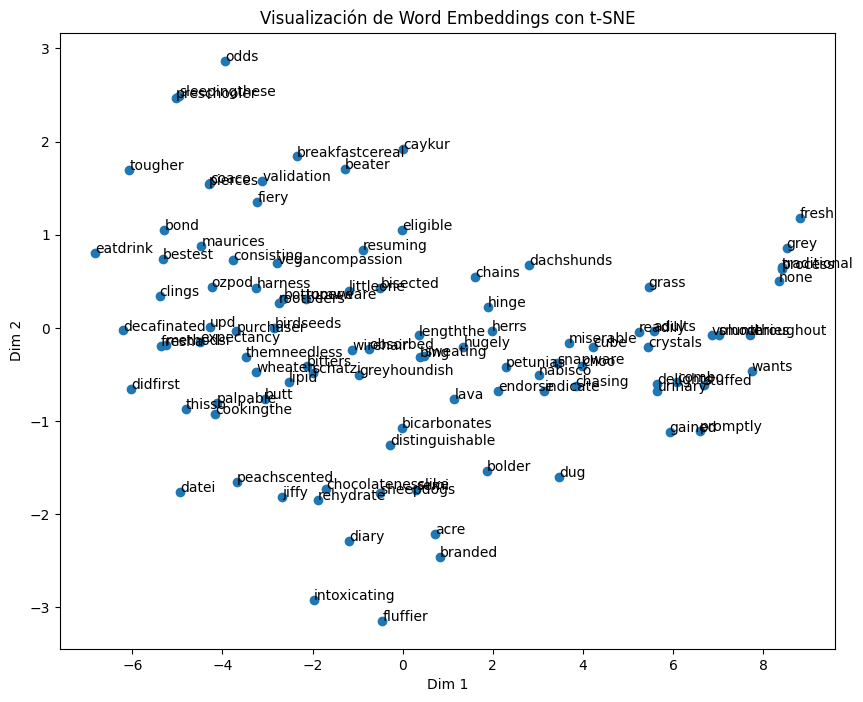

In [ ]:
# Convertir la lista a un array de NumPy
word_vectors_array = np.array(word_vectors)

tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(word_vectors_array)

plt.figure(figsize=(10, 8))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
for i, word in enumerate(words):
    plt.annotate(word, (tsne_results[i, 0], tsne_results[i, 1]))
plt.title("Visualización de Word Embeddings con t-SNE")
plt.xlabel("Dim 1")
plt.ylabel("Dim 2")
plt.show()

## Texto "Original"

In [ ]:
#TOLENIZACIÓN
tokenized_text = [word_tokenize(text) for text in original_text_data]

In [ ]:
#Entrenamiento Word2Vecc
model = Word2Vec(tokenized_text, vector_size=100, window=5, min_count=1, sg=0, workers=2)

In [ ]:
# Ver similitud entre palabras
print("Similitud entre 'salt' y 'potato':", model.wv.similarity("potato", "salt"))
print("Palabras más similares a 'nuts':", model.wv.most_similar("nuts"))

Similitud entre 'salt' y 'potato': 0.7698606
Palabras más similares a 'nuts': [('almonds', 0.9750605225563049), ('strips', 0.9535003304481506), ('candies', 0.9489023089408875), ('fruits', 0.9478157758712769), ('potato', 0.9474252462387085), ('coats', 0.9463268518447876), ('baked', 0.9445466995239258), ('peanuts', 0.9413972496986389), ('seeds', 0.9398480653762817), ('cherries', 0.9383041858673096)]


In [ ]:
#Analogía entre palabras
word = "oil"
try:
    analogia = model.wv.most_similar(positive=["salt", "potato"], negative=[word], topn=3)
    print(f"Analogías encontradas para {word}:", analogia)
except KeyError as e:
    print("Error:", e)

Analogías encontradas para oil: [('chip', 0.9436478614807129), ('tortilla', 0.9331910610198975), ('tangy', 0.9078193306922913)]


In [ ]:
words = list(model.wv.index_to_key)
len(words)

22758

### Ejercicio Adicional 3

#### TSNE de embeddings

In [ ]:
#Tomamos aleatoriamente 100 palabras de la lista de words
words = random.sample(words, 100)

In [ ]:
word_vectors = [model.wv[w] for w in words]

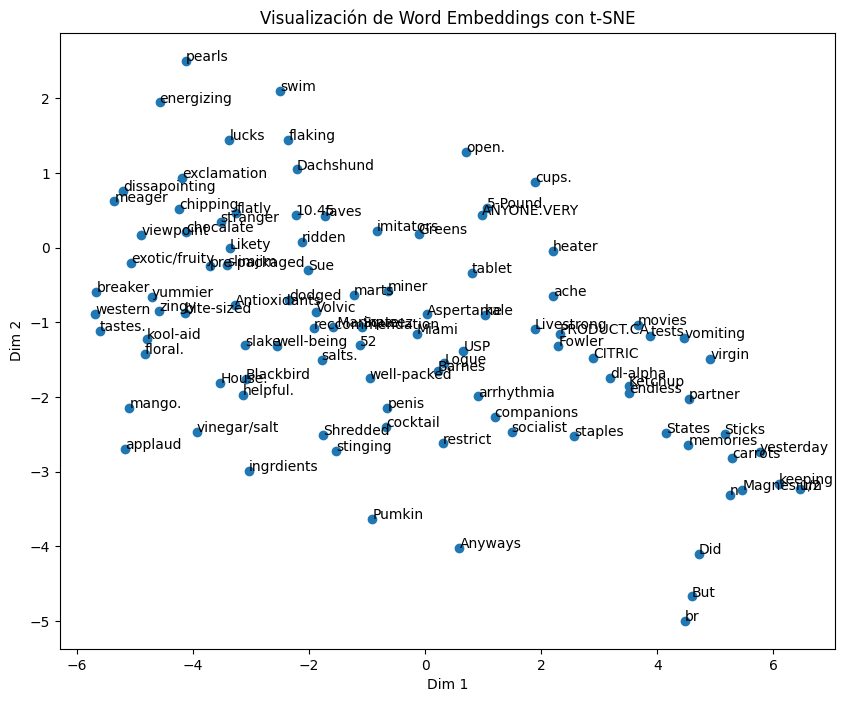

In [ ]:
# Convertir la lista a un array de NumPy
word_vectors_array = np.array(word_vectors)

tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(word_vectors_array)

plt.figure(figsize=(10, 8))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
for i, word in enumerate(words):
    plt.annotate(word, (tsne_results[i, 0], tsne_results[i, 1]))
plt.title("Visualización de Word Embeddings con t-SNE")
plt.xlabel("Dim 1")
plt.ylabel("Dim 2")
plt.show()

<div align="justify">

Ya que hemos entrenado el modelo de Word2Vec con nuestro corpus definido podemos visualizar las palabras en su espacio vectorial; en este caso utilizamos T-SNE para visualizar los datos generados por Word2Vec. T-SNE es realmente útil para representar en un espacio de menor dimensionalidad los grupos de palabras semánticamente relacionadas.
Debido al alto número de palabras obtenido; cerca de 19.600 palabras, y dado a que la representación visual será muy pesada computacionalmente hablando se ha decidido mostrar únicamente 100 palabras aleatorias, esto lo podemos observar en la figura 1 y la figura 2.
En la figura 1 podemos visualizar el t-SNE de las palabras con el corpus "limpio" (aplicado el pre-procesmaiento inicial) y en la figura 2 podemos visualizar las palabras con el texto "original". 
Si bien las agrupaciones de palabras en el texto limpio no parecieran tener una relación directa; seguramente en el contexto del corpus usado estas palabras tengan contextos similares, Por el contrario, con el texto sin limpiar podemos observar relaciones más "comunes" por ejemplo: Did-But-br; o cups-pounds. Si bien esté sea un efecto de haber tomado solo 100 palabras de cada uno de los modelos entrenados; podríamos inferir que los documentos originales mantienen un contexto más diverso sin toda la limpieza que se ha realizado. 

# Ejercicio 4: Analisis de Sentimientos
## Combinado con ejercicio adicional 4

Para este ejercicio utilizamos los modelos entrenados disponibles en Hugging Face. Tenemos que entender que, estos modelos fueron entrenados con muchisimos datos y pueden ser usados para diversas tareas. Los modelos como Bert y Roberta pueden ser usados para hacer análisis de sentimientos, siendo BERT el más "apegado" a nuestros datos. 

In [ ]:

# Cargar el modelo preentrenado
sentiment_pipeline = pipeline("sentiment-analysis", model="nlptown/bert-base-multilingual-uncased-sentiment")
sentiment_pipeline_2 = pipeline("sentiment-analysis", model="cardiffnlp/twitter-xlm-roberta-base-sentiment")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Device set to use cpu
Device set to use cpu


## Texto Limpio

#### Modelo 1

In [ ]:
count = 1;
for text in text_data:
  if count == 5:
    break;
  sentiment = sentiment_pipeline(text)[0]
  print(f"Texto: {text}\nSentimiento: {sentiment['label']} ({sentiment['score']:.2f})\n")
  count += 1;


Texto: having tried a couple of other brands of glutenfree sandwich cookies these are the best of the bunch  theyre crunchy and true to the texture of the other real cookies that arent glutenfree  some might think that the filling makes them a bit too sweet but for me that just means ive satisfied  sweet tooth sooner  the chocolate version from glutino is just as good and has a true chocolatey taste  something that isnt there with the other glutenfree brands out there
Sentimiento: 5 stars (0.46)

Texto:  cat loves these treats if ever i cant find her in the house i just pop the top and she bolts out of wherever she was hiding to come get a treat she doesnt like crunchy treats much so these are perfect for her ive given her all three flavors and she seems to like them all equally they do tend to dry out  the time i near the end of the bottle however the fliptop lid is very handy very nice inexpensive kitty treats i have yet to meet a cat that doesnt just love these
Sentimiento: 4 stars 

### Ejercicio Adicional 4

#### Modelo 2

In [ ]:
count = 1;
for text in text_data:
  if count == 5:
    break;
  sentiment = sentiment_pipeline_2(text)[0]
  print(f"Texto: {text}\nSentimiento: {sentiment['label']} ({sentiment['score']:.2f})\n")
  count += 1;


Texto: having tried a couple of other brands of glutenfree sandwich cookies these are the best of the bunch  theyre crunchy and true to the texture of the other real cookies that arent glutenfree  some might think that the filling makes them a bit too sweet but for me that just means ive satisfied  sweet tooth sooner  the chocolate version from glutino is just as good and has a true chocolatey taste  something that isnt there with the other glutenfree brands out there
Sentimiento: neutral (0.36)

Texto:  cat loves these treats if ever i cant find her in the house i just pop the top and she bolts out of wherever she was hiding to come get a treat she doesnt like crunchy treats much so these are perfect for her ive given her all three flavors and she seems to like them all equally they do tend to dry out  the time i near the end of the bottle however the fliptop lid is very handy very nice inexpensive kitty treats i have yet to meet a cat that doesnt just love these
Sentimiento: positive

## Texto "Original"

#### Modelo 1

In [ ]:
count = 1;
for text in original_text_data:
  if count == 5:
    break;
  sentiment = sentiment_pipeline(text)[0]
  print(f"Texto: {text}\nSentimiento: {sentiment['label']} ({sentiment['score']:.2f})\n")
  count += 1;


Texto: Having tried a couple of other brands of gluten-free sandwich cookies, these are the best of the bunch.  They're crunchy and true to the texture of the other "real" cookies that aren't gluten-free.  Some might think that the filling makes them a bit too sweet, but for me that just means I've satisfied my sweet tooth sooner!  The chocolate version from Glutino is just as good and has a true "chocolatey" taste - something that isn't there with the other gluten-free brands out there.
Sentimiento: 5 stars (0.58)

Texto: My cat loves these treats. If ever I can't find her in the house, I just pop the top and she bolts out of wherever she was hiding to come get a treat. She doesn't like crunchy treats much, so these are perfect for her. I've given her all three flavors and she seems to like them all equally. They do tend to dry out by the time I near the end of the bottle, however. The flip-top lid is very handy. Very nice, inexpensive kitty treats. I have yet to meet a cat that doesn

### Ejercicio Adicional 4

#### Modleo 2

In [ ]:
count = 1;
for text in original_text_data:
  if count == 5:
    break;
  sentiment = sentiment_pipeline_2(text)[0]
  print(f"Texto: {text}\nSentimiento: {sentiment['label']} ({sentiment['score']:.2f})\n")
  count += 1;

Texto: Having tried a couple of other brands of gluten-free sandwich cookies, these are the best of the bunch.  They're crunchy and true to the texture of the other "real" cookies that aren't gluten-free.  Some might think that the filling makes them a bit too sweet, but for me that just means I've satisfied my sweet tooth sooner!  The chocolate version from Glutino is just as good and has a true "chocolatey" taste - something that isn't there with the other gluten-free brands out there.
Sentimiento: neutral (0.34)

Texto: My cat loves these treats. If ever I can't find her in the house, I just pop the top and she bolts out of wherever she was hiding to come get a treat. She doesn't like crunchy treats much, so these are perfect for her. I've given her all three flavors and she seems to like them all equally. They do tend to dry out by the time I near the end of the bottle, however. The flip-top lid is very handy. Very nice, inexpensive kitty treats. I have yet to meet a cat that doesn

## Original Label and Text

In [ ]:
df_foodReview[["Score", "Text"]].head(4)

,Score,Text
165256,5,Having tried a couple of other brands of glute...
231465,5,My cat loves these treats. If ever I can't fin...
427827,3,A little less than I expected. It tends to ha...
433954,2,"First there was Frosted Mini-Wheats, in origin..."


Podmeos observar que, el modelo BERT, con el texto limpio tiene una menor inferencia. Al contrario, con el texto original la inferencia es prácticamente 100% acertada. Esto puede deberse a que al haber eliminado los caracateres de puntuación, dígitos, etc.  el texto se ha vuelto más neutral; lo que puede afectar al modelo en su tarea de diferenciar entre las clases de sentimiento (es decir, se ha perdido información contextual clave durante el preprocesamiento).

Adicionalmente, al haber usado ROBERTA como modelo para comparar, este modelo, al tener seguramente un cabezal de clasificación con solamente 3 categorigas; a diferencia de BERT que tiene 5 categorias; es un poco más ambiguo intentar verificar si el modelo es mejor que BERT, sin embargo si tomamos a los puntajes 5 y 4 como "positivo"; 3 como neutral y; 2 y 1 como negativo podeoms inferir que ROBERTA tiene un desempeño mucho menor a BERT sin importar si lo usamos con el texto limpio o el original